# [E-10] 인공지능으로 세상에 없던 새로운 패션 만들기

이번 프로젝트는 생성형 모델 중 가장 중요한 GAN(Generative Adversarial Network)의 개념을 파악하고, <br>
DCGAN 구조를 이용하여 간단한 이미지 생성을 진행해보는 것이 목표이다.

<hr>

## 1. 데이터셋 구성

In [1]:
import os
import glob
import time

import PIL
import imageio
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
from IPython import display
import matplotlib.pyplot as plt

In [2]:
cifar10 = tf.keras.datasets.cifar10

(train_x, _), (test_x, _) = cifar10.load_data()

print(train_x.shape)
print(test_x.shape)

(50000, 32, 32, 3)
(10000, 32, 32, 3)


In [3]:
print("max pixel:", train_x.max())
print("min pixel:", train_x.min())

max pixel: 255
min pixel: 0


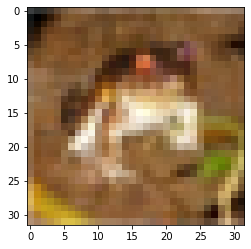

In [4]:
plt.imshow(train_x[0])
plt.show()

In [5]:
train_img = train_x
train_x = (train_x - 127.5) / 127.5 # 이미지를 [-1, 1]로 정규화

print("max pixel:", train_x.max())
print("min pixel:", train_x.min())

max pixel: 1.0
min pixel: -1.0


0 ~ 255 범위로 된 train_x 데이터들의 중간값을 0으로 하기 위해 127.5를 빼준 후 127.5로 나누어주는 정규화 작업을 진행했다.

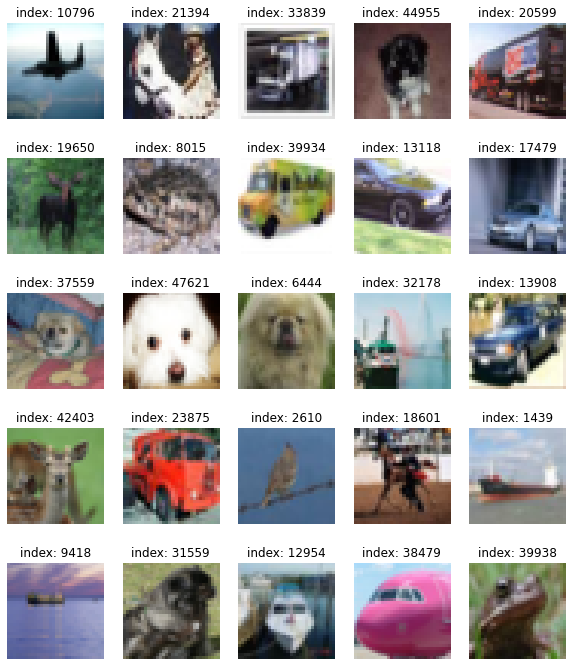

In [6]:
#랜덤으로 정규화 한 이미지 추출

plt.figure(figsize=(10, 12))

for i in range(25):
    plt.subplot(5, 5, i+1)
    random_index = np.random.randint(1, 50000)
    plt.imshow(train_img[random_index])
    plt.title(f'index: {random_index}')
    plt.axis('off')
plt.show()

In [7]:
#미니배치 데이터셋 구성
BUFFER_SIZE = 60000   
BATCH_SIZE = 256   

train_dataset = tf.data.Dataset.from_tensor_slices(train_x).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
train_dataset

<BatchDataset shapes: (None, 32, 32, 3), types: tf.float64>

데이터가 골고루 섞이도록 버퍼 사이즈는 60,000으로 설정하였다.

<hr>

## 2. 생성자 모델 구현

In [8]:
def make_generator_model():

    # Start
    model = tf.keras.Sequential()

    # First: Dense layer
    model.add(layers.Dense(4*4*256, use_bias=False, input_shape=(100,)))
    model.add(layers.LeakyReLU(alpha=0.2))

    # Second: Reshape layer
    model.add(layers.Reshape((4, 4, 256)))

    # Third: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(128, kernel_size=(4, 4), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU(alpha=0.2))

    # Fourth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(128, kernel_size=(4, 4), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU(alpha=0.2))

    # Fifth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(128, kernel_size=(4, 4), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU(alpha=0.2))
    
    # Sixth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(3, kernel_size=(3, 3), padding='same', activation='tanh'))

    return model

In [9]:
#생성모델
generator = make_generator_model()
generator.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 4096)              409600    
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 4096)              0         
_________________________________________________________________
reshape (Reshape)            (None, 4, 4, 256)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 8, 8, 128)         524416    
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 8, 8, 128)         0         
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 16, 16, 128)       262272    
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 16, 16, 128)       0

In [10]:
# 랜덤 노이즈 벡터 생성
noise = tf.random.normal([1, 100])

# 생성자 모델에 노이즈를 입력하고 이미지 생성
generated_image = generator(noise, training=False)
generated_image.shape

TensorShape([1, 32, 32, 3])

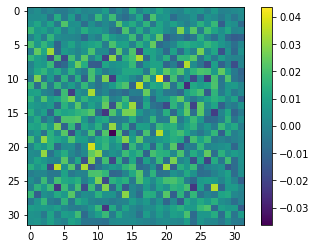

In [11]:
plt.imshow(generated_image[0, :, :, 0])
plt.colorbar()
plt.show()

아직 학습을 시작하기 전이므로 아무 의미가 없는 이미지가 생성되었다.

<hr>

## 3. 판별자 모델 구현

In [12]:
def make_discriminator_model():

    # Start
    model = tf.keras.Sequential()

    # First: Conv2D Layer
    model.add(layers.Conv2D(64, (3, 3), strides=(2, 2), padding='same', input_shape=[32, 32, 3]))
    model.add(layers.LeakyReLU(alpha=0.2))
    
    # Second: Conv2D Layer
    model.add(layers.Conv2D(128, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU(alpha=0.2))
    
    # Third: Conv2D Layer
    model.add(layers.Conv2D(128, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU(alpha=0.2))
    
    # Fourth: Conv2D Layer
    model.add(layers.Conv2D(256, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU(alpha=0.2))
    
    # Fifth: Flatten Layer
    model.add(layers.Flatten())
    model.add(layers.Dropout(0.4))
        
    # Sixth: Dense Layer
    model.add(layers.Dense(1, activation='sigmoid'))

    return model

In [13]:
discriminator = make_discriminator_model()

discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 16, 16, 64)        1792      
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 16, 16, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 8, 8, 128)         73856     
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 8, 8, 128)         0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 4, 4, 128)         147584    
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 4, 4, 128)         0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 2, 2, 256)        

In [14]:
decision = discriminator(generated_image, training=False)
decision

<tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[0.49984026]], dtype=float32)>

<hr>

## 4. 손실 함수와 최적화 함수 구현

### 손실 함수

In [15]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def discriminator_accuracy(real_output, fake_output):
    real_accuracy = tf.reduce_mean(tf.cast(tf.math.greater_equal(real_output, tf.constant([0.5])), tf.float32))
    fake_accuracy = tf.reduce_mean(tf.cast(tf.math.less(fake_output, tf.constant([0.5])), tf.float32))
    return real_accuracy, fake_accuracy

### 최적화 함수

최적화 함수는 Adam을 사용하고, 생성할 샘플들은 같은 노이즈로 생성하기 위해 16개의 고정된 seed를 만들어준다.

In [16]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, 0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, 0.5)

noise_dim = 100
num_examples_to_generate = 16

seed = tf.random.normal([num_examples_to_generate, noise_dim])
seed.shape

TensorShape([16, 100])

<hr>

## 5. 훈련 과정 상세 기능 구현

In [17]:
@tf.function
def train_step(images):  #(1) 입력데이터
    noise = tf.random.normal([BATCH_SIZE, noise_dim])  #(2) 생성자 입력 노이즈

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:  #(3) tf.GradientTape() 오픈
        generated_images = generator(noise, training=True)  #(4) generated_images 생성

        #(5) discriminator 판별
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        #(6) loss 계산
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

        #(7) accuracy 계산
        real_accuracy, fake_accuracy = discriminator_accuracy(real_output, fake_output) 
    
    #(8) gradient 계산
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    #(9) 모델 학습
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return gen_loss, disc_loss, real_accuracy, fake_accuracy  #(10) 리턴값

In [18]:
def generate_and_save_images(model, epoch, it, sample_seeds):

    predictions = model(sample_seeds, training=False)
        
    fig = plt.figure(figsize=(4, 4))
    for i in range(predictions.shape[0]):
        denorm_predictions = predictions.numpy()
        denorm_predictions = (denorm_predictions * 127.5) + 127.5 
        denorm_predictions = denorm_predictions.astype(int)
        plt.subplot(4, 4, i+1)
        plt.imshow(denorm_predictions[i])
        plt.axis('off')
        
    plt.savefig('{}/aiffel/dcgan_newimage/cifar10/generated_samples/sample_epoch_{:04d}_iter_{:03d}.png'
                    .format(os.getenv('HOME'), epoch, it))
    plt.show()

In [19]:
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 6

def draw_train_history(history, epoch):
    # summarize history for loss  
    plt.subplot(211)  
    plt.plot(history['gen_loss'])  
    plt.plot(history['disc_loss'])  
    plt.title('model loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')  

    # summarize history for accuracy  
    plt.subplot(212)  
    plt.plot(history['fake_accuracy'])  
    plt.plot(history['real_accuracy'])  
    plt.title('discriminator accuracy')  
    plt.ylabel('accuracy')  
    plt.xlabel('batch iters')  
    plt.legend(['fake_accuracy', 'real_accuracy'], loc='upper left')  
    
    # training_history 디렉토리에 epoch별로 그래프를 이미지 파일로 저장
    plt.savefig('{}/aiffel/dcgan_newimage/cifar10/training_history/train_history_{:04d}.png'
                    .format(os.getenv('HOME'), epoch))
    plt.show()

In [20]:
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/training_checkpoints'

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

<hr>

## 6. 학습 과정 진행 및 결과 확인

In [21]:
def train(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                display.clear_output(wait=True)
                generate_and_save_images(generator, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        display.clear_output(wait=True)
        generate_and_save_images(generator, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch)

In [34]:
save_every = 5
EPOCHS = 300

# 사용가능한 GPU 디바이스 확인.
tf.config.list_physical_devices("GPU")

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

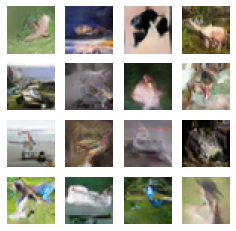

Time for training : 6884 sec


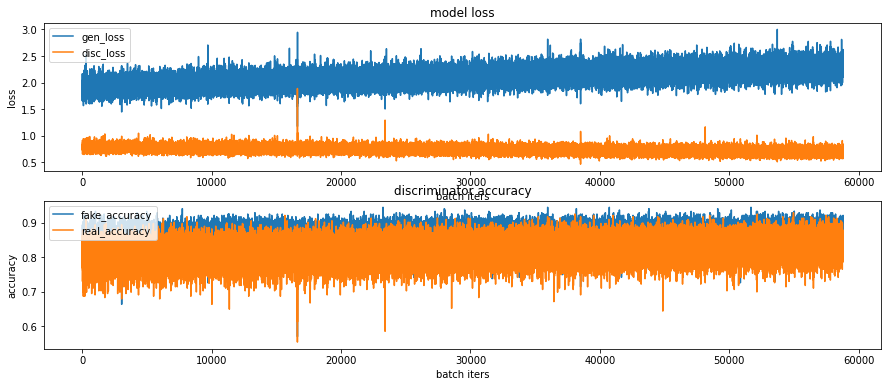

CPU times: user 1h 57min 39s, sys: 8min 15s, total: 2h 5min 55s
Wall time: 1h 54min 48s


In [35]:
%%time
train(train_dataset, EPOCHS, save_every)

In [36]:
anim_file = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/cifar10_dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('{}/aiffel/dcgan_newimage/cifar10/generated_samples/sample*.png'.format(os.getenv('HOME')))
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

!ls -l ~/aiffel/dcgan_newimage/cifar10/cifar10_dcgan.gif

-rw-r--r-- 1 root root 2128470 Feb 15 13:00 /aiffel/aiffel/dcgan_newimage/cifar10/cifar10_dcgan.gif


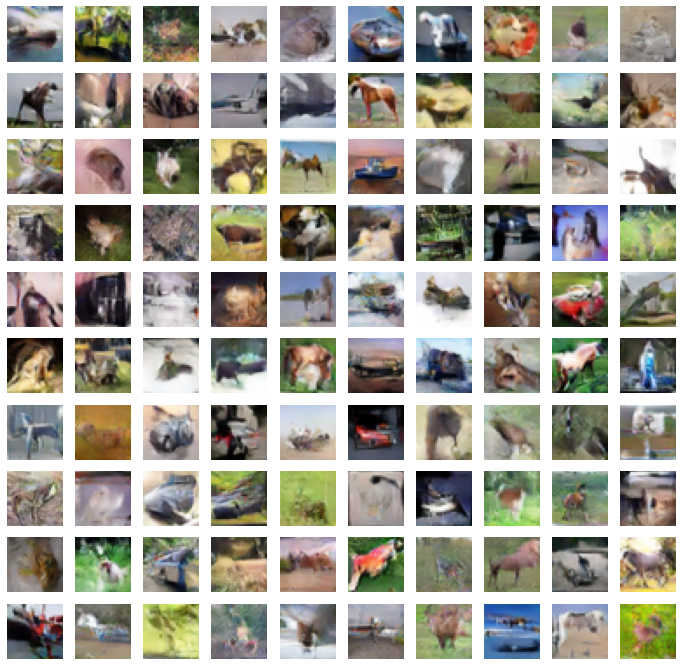

In [37]:
# checkpoint를 통해 모델 로드
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/training_checkpoints'

latest = tf.train.latest_checkpoint(checkpoint_dir)
checkpoint.restore(latest)

generator = checkpoint.generator
discriminator = checkpoint.discriminator

# 로드한 모델이 정상적으로 이미지를 생성하는지 확인
plt.figure(figsize=(12, 12))

for i in range(100):
    plt.subplot(10, 10, i+1)
    noise = tf.random.normal([1, 100])
    generated_image = generator(noise, training=False)
    np_generated = generated_image.numpy()
    np_generated = (np_generated * 127.5) + 127.5   # reverse of normalization
    np_generated = np_generated.astype(int)
    plt.imshow(np_generated[0])
    plt.axis('off')
plt.show()

<hr>

## 7. 모델 성능 개선 과정

## 첫 번째 시도

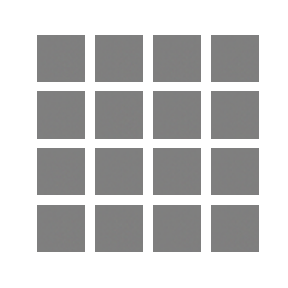

에포크 값을 아무리 올려도 결과물이 나오지 않아 로컬 환경 문제로 보여 클라우드 환경에서 다시 작업을 시작했다.

<hr>

## 두 번째 시도

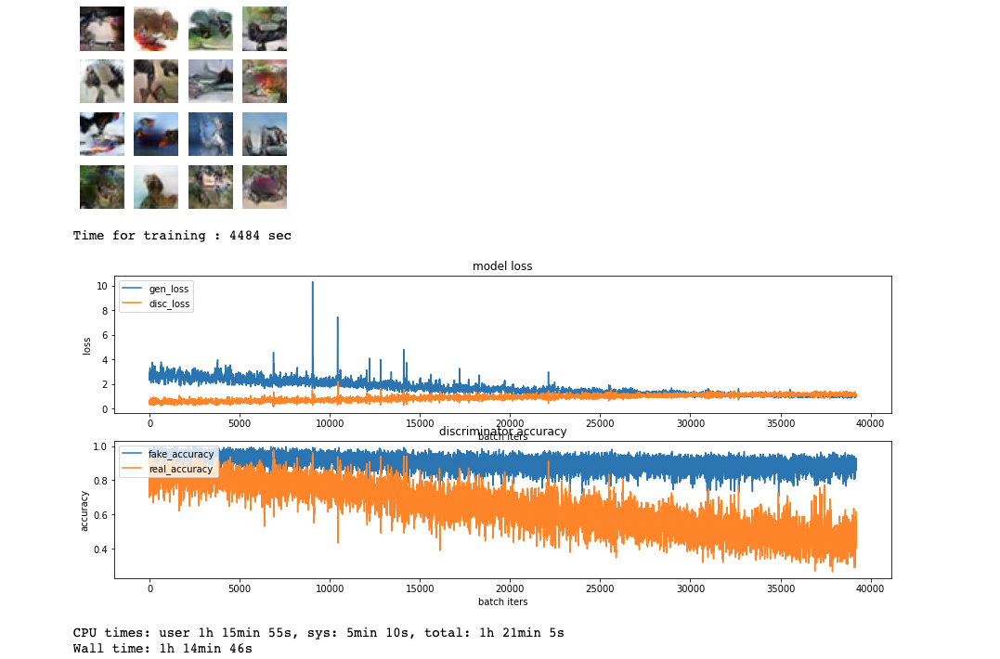

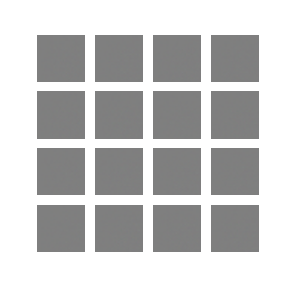

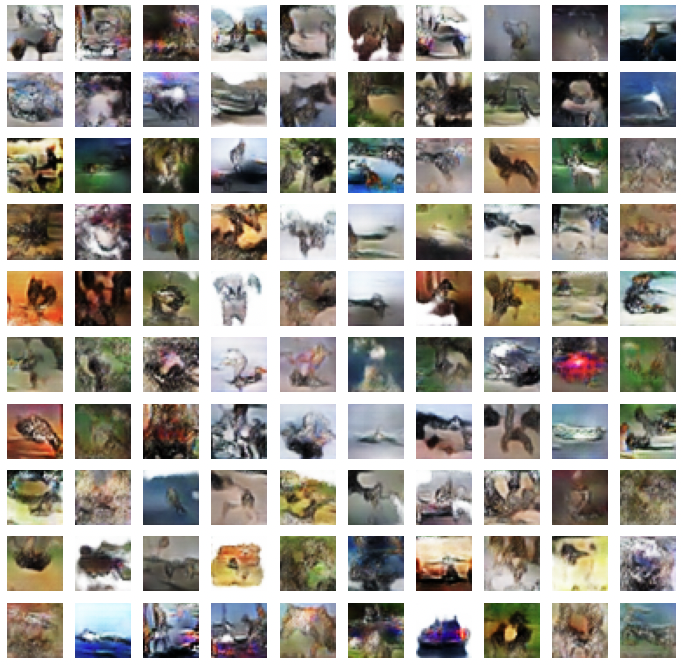

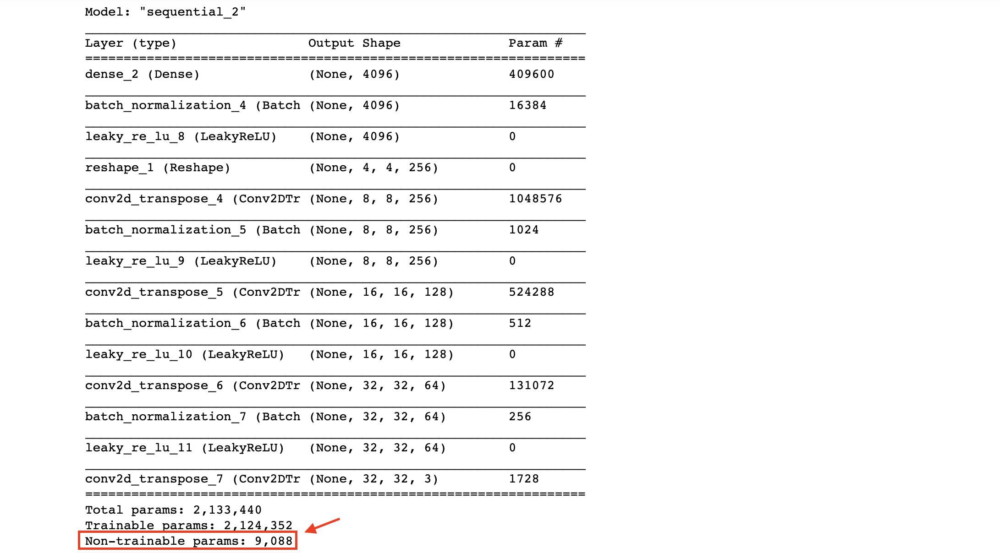

BatchNormalization를 사용하는 과정에서 역전파로 훈련되지 않은 파라미터로 추정된다. BatchNormalization를 주석처리하고 파라미터를 변경하여 다시 훈련을 해보았다.

<hr>

## 세 번째 시도

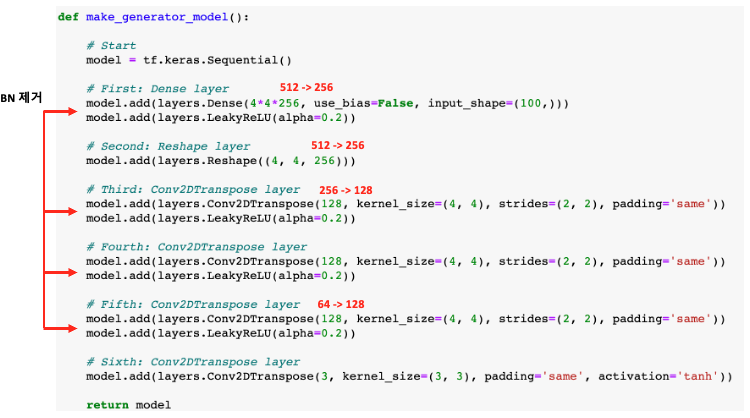

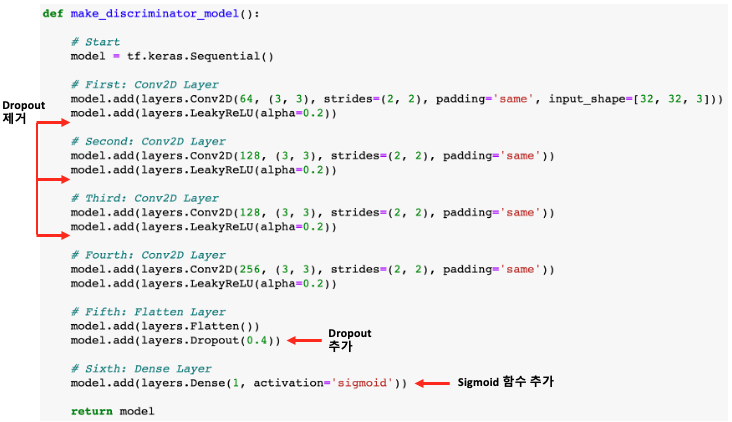

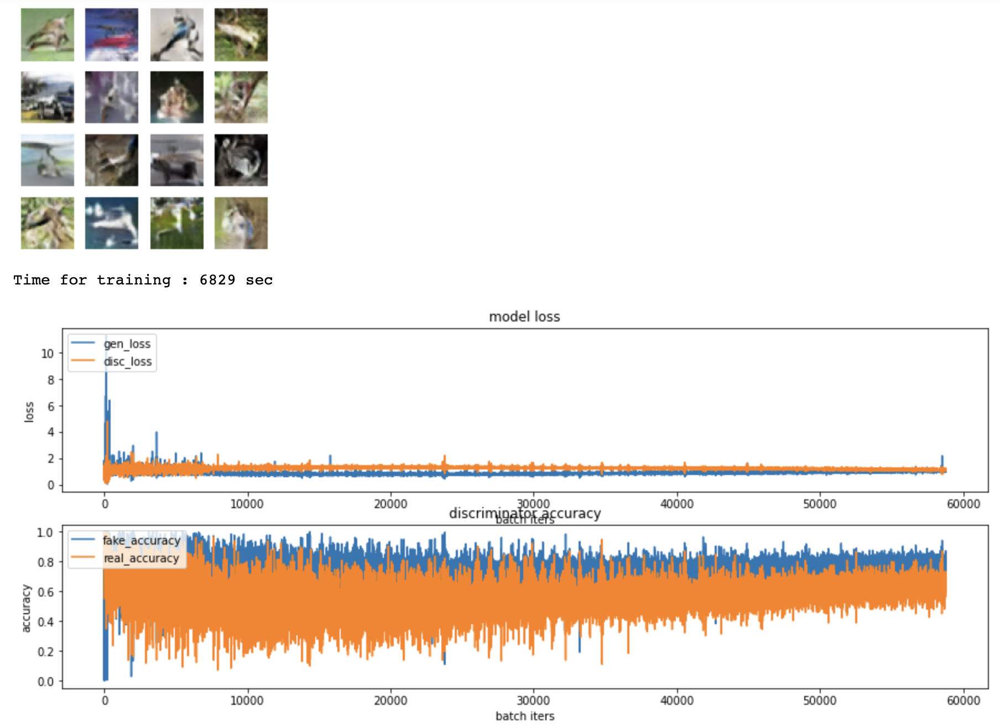

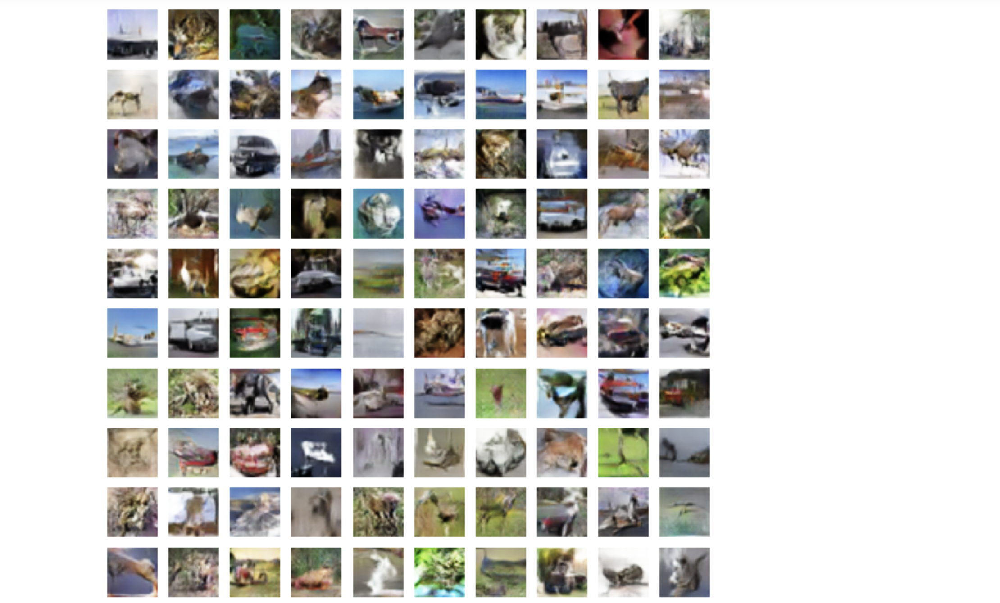

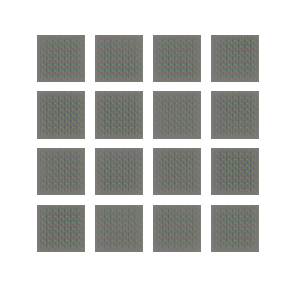

<hr>

## 추가 학습

#### 에포크 200 추가 학습 (EPOCHS = 500)

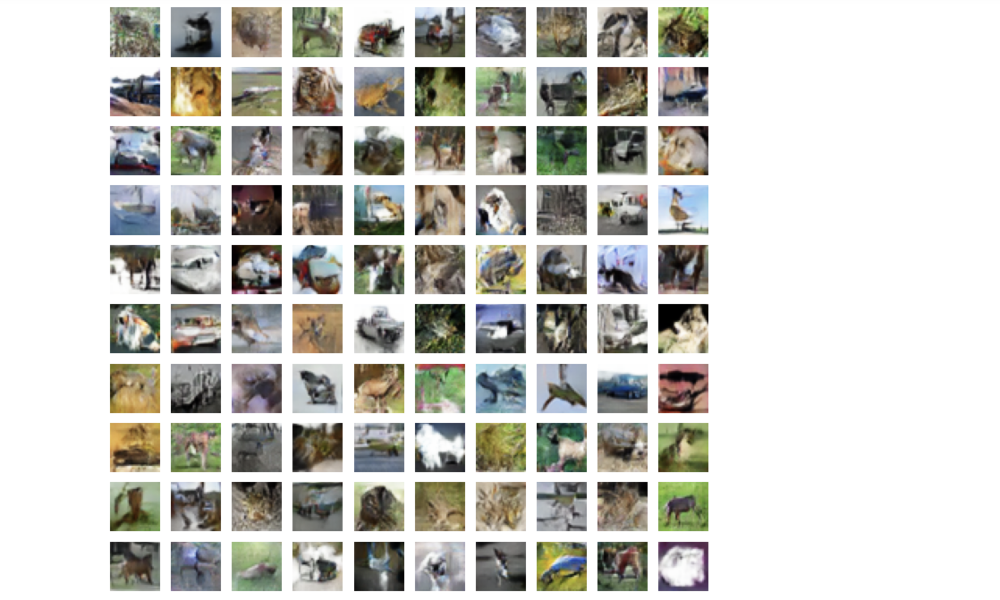

#### 에포크 200 추가 학습 (EPOCHS = 700)

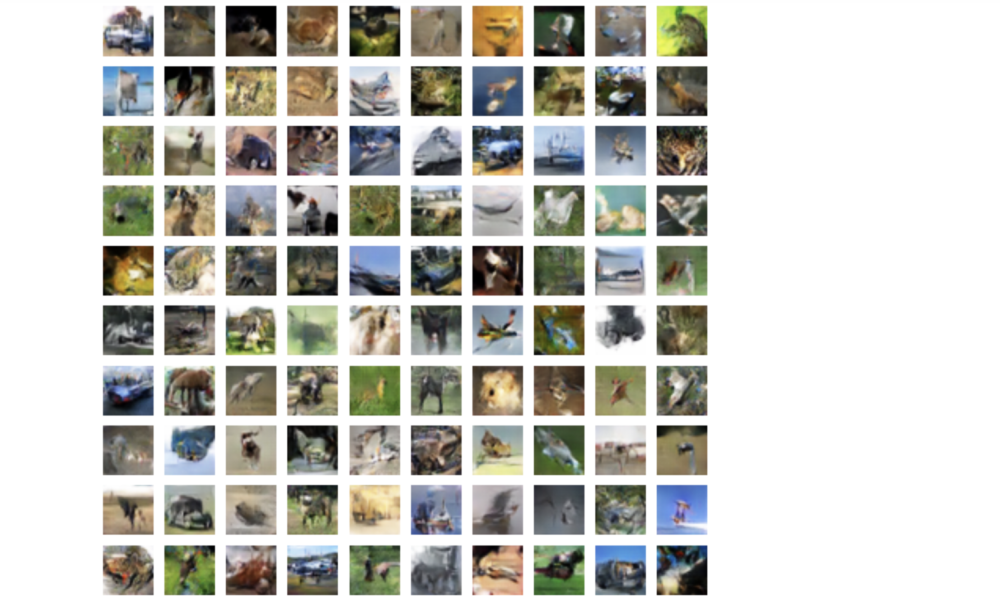

#### 에포크 300 추가 학습 (EPOCHS = 1,000)

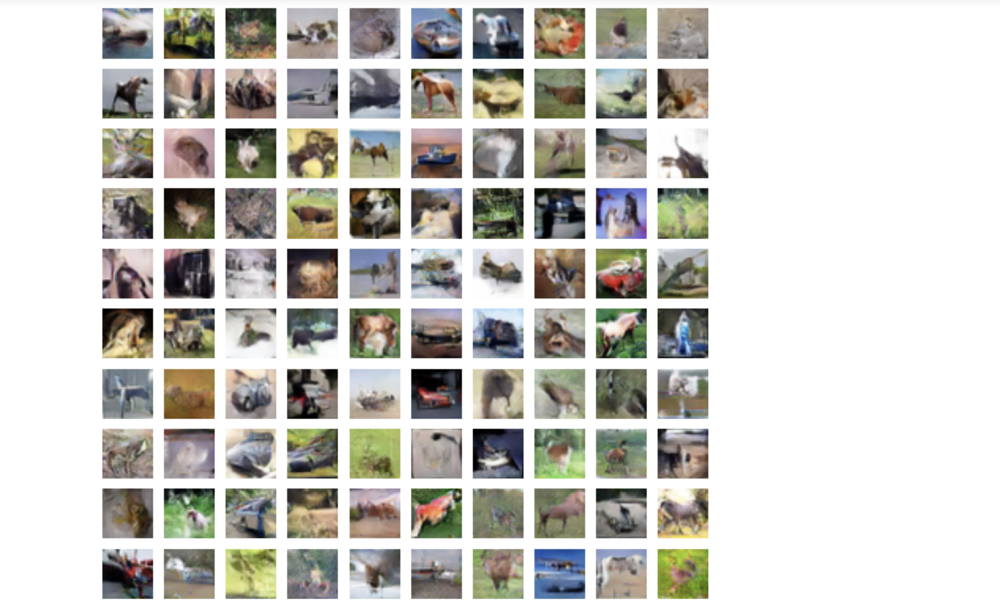

<hr>

## 프로젝트를 마치며

이번 프로젝트는 GAN 모델을 활용하여 cifar10에 없는 이미지를 생성해내는 것이 목표였다. 첫 모델을 만들고 학습시는 과정에서 500 에포크로 학습시켜도 결과물이 나오지 않아 모델을 수정하는데에 시간이 정말 오래 걸렸다. 하지만 코드를 그대로 아이펠 클라우드 주피터 노트북으로 실행해보니 결과물이 정상적으로 나온 것을 확인하였고 결국 프로젝트 환경 문제였던 것임을 알게 되었다. 원인을 찾아보고자 했지만 결국 찾지는 못했고 Mac M1에서 지원하는 텐서플로우나 다른 라이브러리에서의 버전 문제로 추측하고 있다. 시간이 될 때 이 부분은 조금 더 조사해봐야겠다.

두 번째 모델에서는 결과물이 조금은 알아볼 수 있을 정도로 나왔다. 하지만 이미지가 나타내는 객체가 어떤 것인지 알아차릴 수 있을 정도의 결과물은 아니었다. epochs는 300으로 학습시켰고 real_accuracy는 점차 감소하는 추세를 보였다. non-trainable params도 9,088개나 되었고 이는 BatchNormalization를 사용하는 과정에서 역전파로 훈련되지 않은 파라미터로 추정된다. 이러한 이유들로 나는 성능이 좋은 모델이라고 생각하지 않았고 개선시키기 위한 새로운 모델을 만들었다.

세 번째 모델에서는 생성자 모델에서 BatchNormalization를 주석처리하고 파라미터를 변경하여 다시 훈련을 해보았다. 판별자 모델에서는 각 레이어에서 적용시켰던 Dropout를 삭제하고 Flatten Layer에서 Dropout을 0.4비율로 추가하였다. 그 밖에 Dense Layer에는 Sigmoid 함수를 추가하였고 여러 하이퍼 파라미터들을 수정해주는 작업을 해주었다. 그 결과, 몇 개의 이미지에서는 객체를 알아볼 수 있을 정도의 결과물이 나오게 되었다. 두 번째 모델에서 감소하던 real_accuracy는 점차 증가하는 추세를 보였고 fake_accuracy는 점차 감소하는 추세를 보였다.

세 번째 모델의 성능이 충분하다고 판단하였고 300이었던 epochs를 500까지 추가로 학습시켰다. 그 후, 에포크를 700 그리고 1000까지 학습시켰다. 학습을 시킬수록 육안으로 확인이 가능한 이미지가 점점 늘어났고 왜곡된 이미지들도 점차 개선되어 가는 것을 확인할 수 있었다.

이번 프로젝트를 진행하면서 GAN의 모델 구조와 학습 과정을 개선시키기 위한 방법들에 대해 공부하고 적용시키면서 많은 것들을 얻어갈 수 있었던 것 같다. 처음에는 학습 속도 때문에 절망적이었지만 이번에 배운 checkpoint를 활용하니 많은 도움이 되었다. checkpoint를 이제서야 알게 되었다는 생각에 지난 프로젝트들이 머릿속을 스쳐지나갔지만 그래도 앞으로의 모델 학습에서 유용하게 사용할 수 있는 스킬을 얻었다는 생각에 뿌듯하다.